
# Assignment 3

This is a template notebook for Assignment 3.


## Install dependencies and initialization

In [ ]:
# # The next 8 lines added to be compatible with version changes (2022/10/13).
# # change cuda to 11.1
# import os
# p = os.getenv('PATH')
# ld = os.getenv('LD_LIBRARY_PATH')
# os.environ['PATH'] = f"/usr/local/cuda-11.1/bin:{p}"
# os.environ['LD_LIBRARY_PATH'] = f"/usr/local/cuda-11.1/lib64:{ld}"
# # change pytorch to 1.9.0 compiled with cuda 11.1
# !pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html


# # install dependencies:
# !pip install pyyaml==5.1 pycocotools>=2.0.1
# # !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html

In [1]:
!python3 -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python3 -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

fatal: destination path 'detectron2' already exists and is not an empty directory.


In [18]:
# torch.cuda.empty_cache()

In [2]:
!pwd # shows current directory
!ls  # shows all files in this directory
!nvidia-smi # shows the specs and the current status of the allocated GPU

/home/shane/cmpt412/project3
balloon			   input.jpg   video-clip.mp4
balloon_dataset.zip	   lab3.ipynb  video.mp4
detectron2		   __MACOSX    video-output.mkv
Detectron2_Tutorial.ipynb  output
Wed Nov  1 09:26:10 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.113.01             Driver Version: 535.113.01   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 3090        Off | 00000000:09:00.0  On |                  N/A |
|  0%   30C    P8              47W / 350W |    687MiB / 

In [5]:
# import some common libraries
# from google.colab.patches import cv2_imshow
from sklearn.metrics import jaccard_score
from PIL import Image, ImageDraw
from tqdm.notebook import tqdm
import pandas as pd
import numpy as np
import datetime
import random
import json
import cv2
import csv
import os
import logging
logging.getLogger('matplotlib').setLevel(logging.WARNING)
logging.getLogger("PIL").setLevel(logging.ERROR)
%matplotlib inline
import matplotlib.pyplot as plt

# import some common pytorch utilities
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torch.autograd import Variable
import torch.nn.functional as F
import torch.nn as nn
import torch

# import some common detectron2 utilities
import detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import Visualizer
from detectron2.data import build_detection_test_loader
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
setup_logger()

<Logger detectron2 (DEBUG)>

In [6]:
# Make sure that GPU is available for your notebook.
# Otherwise, you need to update the settungs in Runtime -> Change runtime type -> Hardware accelerator
torch.cuda.is_available()

True

In [ ]:
# # You need to mount your google drive in order to load the data:
# from google.colab import drive
# drive.mount('/content/drive')
# Put all the corresponding data files in a data folder and put the data folder in a same directory with this notebook.
# Also create an output directory for your files such as the trained models and the output images.

In [7]:
# Define the location of current directory, which should contain data/train, data/test, and data/train.json.
# TODO: approx 1 line
#-------------POPOS LOCAL
BASE_DIR = '/home/shane/lab3/data'#'/content/drive/My Drive/CMPT_CV_lab3'
OUTPUT_DIR = '{}/output'.format(BASE_DIR)#'{}/output'.format('/content/drive/My Drive/CMPT_CV_lab3')#'{}/output'.format(BASE_DIR)
os.makedirs(OUTPUT_DIR, exist_ok=True)

#------------WSL2 LOCAL
# BASE_DIR = '/mnt/c/Users/shane/Downloads/lab3-data'#'/content/drive/My Drive/CMPT_CV_lab3'
# OUTPUT_DIR = '{}/output'.format(BASE_DIR)#'/home/shane/lab3/output'#'{}/output'.format(BASE_DIR)#'{}/output'.format('/content/drive/My Drive/CMPT_CV_lab3')#'{}/output'.format(BASE_DIR)
# os.makedirs(OUTPUT_DIR, exist_ok=True)


In [ ]:
# !mkdir /data
# !cp -r '/content/drive/My Drive/CMPT_CV_lab3/data/' /data
# # !cp -r '/content/drive/My Drive/CMPT_CV_lab3/data/test' /data/

## Part 1: Object Detection

### Data Loader

In [8]:
'''
# This function should return a list of data samples in which each sample is a dictionary.
# Make sure to select the correct bbox_mode for the data
# For the test data, you only have access to the images, therefore, the annotations should be empty.
# Other values could be obtained from the image files.
# TODO: approx 35 lines
'''

def get_detection_data(set_name):
    data_dirs = BASE_DIR#'{}/data'.format(BASE_DIR)
    set_dirs = '{}/{}'.format(data_dirs,set_name)
    dataset = []


    if set_name == 'train':
        json_file = os.path.join(data_dirs, "train.json")

        with open(json_file) as jf:
            img_ann = json.load(jf)

        for i, v in enumerate(img_ann):
            record={}
            file_name = os.path.join(set_dirs,v['file_name'])
            find_flag = False

            d_idx = 0
            for d in dataset: #look through the dataset list to make sure image does exit
                if d.get('file_name') == file_name:#v['file_name'] in d:
                    find_flag = True
                    break
                d_idx = d_idx + 1

            if find_flag:
                d = dataset[d_idx]
                #this image is already part the growing dictionary list
                # file_name, height and width are already there
                #grab the list of annotations
                annos = d['annotations']
                obj = {
                    'bbox': v['bbox'],
            #             'bbox_mode': BoxMode.XYXY_ABS,
                    'bbox_mode': BoxMode.XYWH_ABS,
                    'segmentation': v['segmentation'],
                    'category_name': v['category_name'],
                    'category_id' : 0, #v['category_id'],
                }
                annos.append(obj) #add the annotations to existing

            else:
                #this json record is not part of the growing dataset dict so add it
                image = cv2.imread(file_name)
                height, width = image.shape[:2]
                record['file_name'] = file_name
                record['image_id'] = i
                record['height'] = height
                record['width'] = width
                record['image_data'] = image
                objs = []
                obj = {
                    'bbox': v['bbox'],
            #             'bbox_mode': BoxMode.XYXY_ABS,
                    'bbox_mode': BoxMode.XYWH_ABS,
                    'segmentation': v['segmentation'],
                    'category_name': v['category_name'],
                    'category_id' : 0, #v['category_id'],
                }
                objs.append(obj)
                record['annotations'] = objs
                dataset.append(record)

    else: # load the test data
        set_files = os.listdir(set_dirs)
        im_files = [i for i in set_files if i.lower().endswith(('.png','jpg','jpeg'))]

        for im in im_files:
            record={}
            idx = 0

            file_name = os.path.join(set_dirs,im)

#             if im not in image_dict:
#                 image = cv2.imread(file_name)
#                 image_dict[file_name] = image

            image = cv2.imread(file_name)
            height, width = image.shape[:2]
            record['file_name'] = file_name
            record['image_id'] = idx
            record['height'] = height
            record['width'] = width
            record['image_data'] = image
            objs = []
            record['annotations'] = objs
            dataset.append(record)

            idx = idx + 1

    return dataset#, image_dict

In [7]:
# from detectron2.data.dataset_mapper import DatasetMapper
# class CustomDatasetMapper(DatasetMapper):
#     def __init__(self, cfg, is_train=True):
#         super().__init__(cfg, is_train)
#         self.image_data_field = "image_data"

#     def __call__(self, dataset_dict):
#         dataset_dict = super().__call__(dataset_dict)
#         dataset_dict["image"] = dataset_dict[self.image_data_field]
#         return dataset_dict

In [8]:
'''
# Remember to add your dataset to DatasetCatalog and MetadataCatalog
# Consdier "data_detection_train" and "data_detection_test" for registration
# You can also add an optional "data_detection_val" for your validation by spliting the training data
# TODO: approx 5 lines
'''
train_data = get_detection_data('train')
test_data = get_detection_data('test')

# random.shuffle(dataset_dict)

# split = int(len(dataset_dict) * 0.1) # 10% of training data for validation set
# train_data = dataset_dict[:split]
# val_data = dataset_dict[split:]

for d in ["train", "test"]:
    if d == "train":
        DatasetCatalog.register("data_detection_" + d, lambda d=d: train_data)
        MetadataCatalog.get("data_detection_" + d).set(thing_classes=["plane"])
    else:
        DatasetCatalog.register("data_detection_" + d, lambda d=d: test_data)
        MetadataCatalog.get("data_detection_" + d).set(thing_classes=["plane"])

plane_metadata = MetadataCatalog.get("data_detection_train")

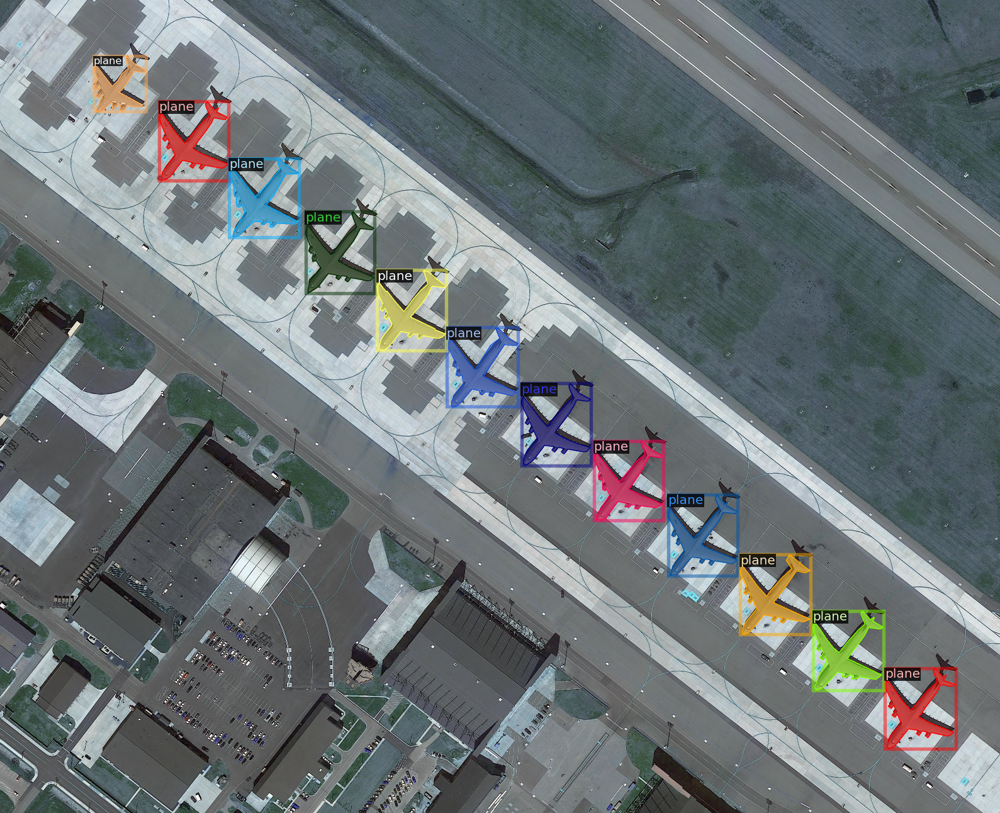

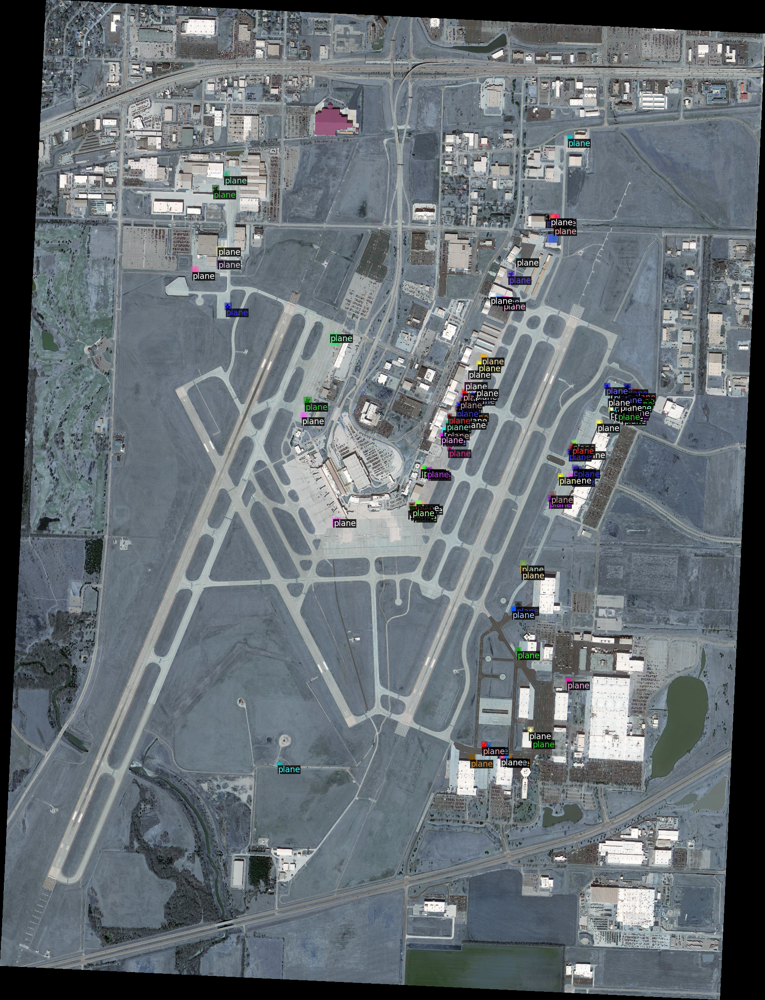

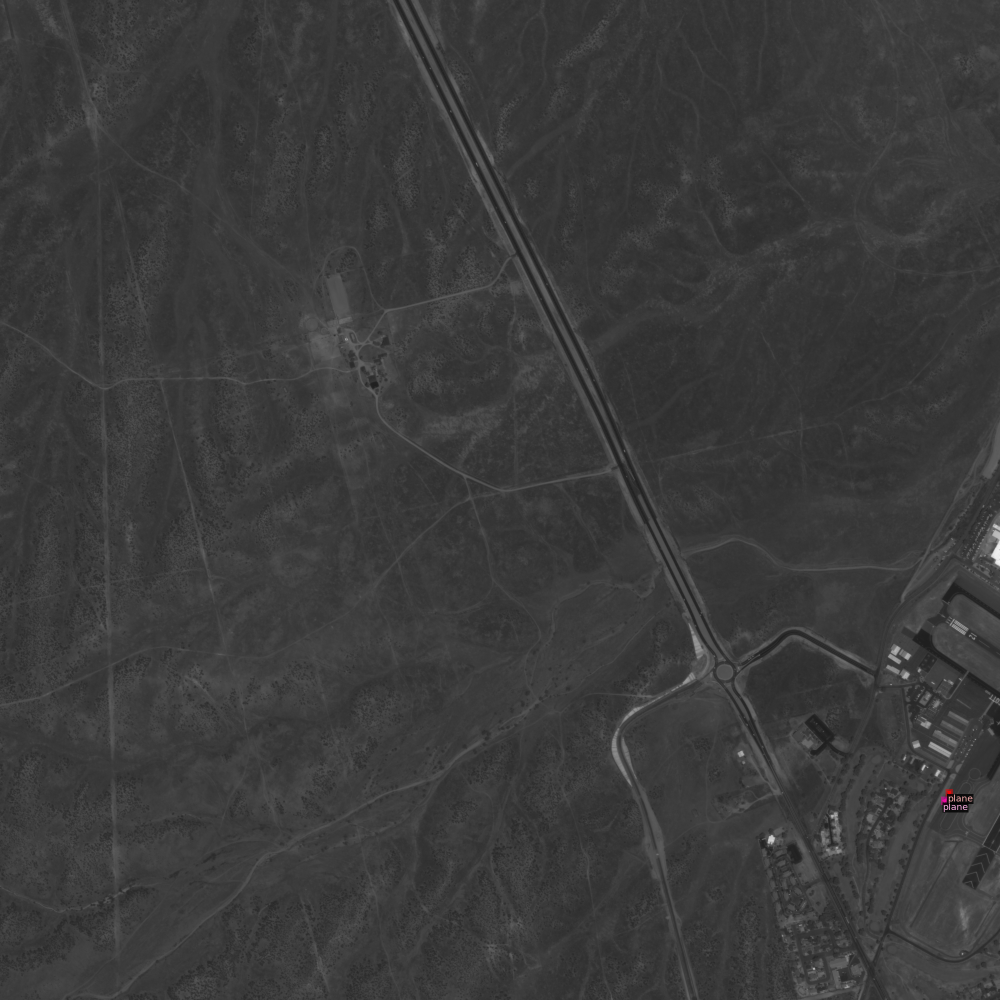

In [9]:
'''
# Visualize some samples using Visualizer to make sure that the function works correctly
# TODO: approx 5 lines
'''


for d in random.sample(train_data, 3):
    #Read the file_name
    img = d['image_data']
    visualizer = Visualizer(img[:, :, ::-1], metadata=plane_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    im = Image.fromarray(out.get_image()[:, :, ::-1])
#     print(d['filename'])
    display(im)


### Set Configs

In [10]:
'''
# Set the configs for the detection part in here.
# TODO: approx 15 lines
'''
cfg = get_cfg()
cfg.OUTPUT_DIR = OUTPUT_DIR#"{}/output/".format(BASE_DIR)
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))#("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("data_detection_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")#("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 500    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512#128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

#To enable the image data to be used instead of reading in the image data again during training
# cfg.INPUT.MAPPER = "CustomDatasetMapper"

### Training

In [11]:
'''
# Create a DefaultTrainer using the above config and train the model
# TODO: approx 5 lines
'''
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[10/31 23:31:47 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

[10/31 23:31:50 d2.engine.train_loop]: Starting training from iteration 0


/home/shane/miniconda3/envs/torch_env/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/31 23:32:09 d2.utils.events]:  eta: 0:04:27  iter: 19  total_loss: 4.238  loss_cls: 0.7257  loss_box_reg: 0.238  loss_rpn_cls: 2.544  loss_rpn_loc: 0.5991    time: 0.9241  last_time: 1.0207  data_time: 0.6060  last_data_time: 0.7728   lr: 9.7405e-06  max_mem: 4018M
[10/31 23:32:23 d2.utils.events]:  eta: 0:04:16  iter: 39  total_loss: 1.845  loss_cls: 0.624  loss_box_reg: 0.2729  loss_rpn_cls: 0.4919  loss_rpn_loc: 0.4433    time: 0.7951  last_time: 0.1964  data_time: 0.4462  last_data_time: 0.0092   lr: 1.9731e-05  max_mem: 4018M
[10/31 23:32:39 d2.utils.events]:  eta: 0:04:10  iter: 59  total_loss: 1.372  loss_cls: 0.5178  loss_box_reg: 0.2738  loss_rpn_cls: 0.2568  loss_rpn_loc: 0.2474    time: 0.7940  last_time: 1.0018  data_time: 0.5601  last_data_time: 0.8347   lr: 2.972e-05  max_mem: 4494M
[10/31 23:32:57 d2.utils.events]:  eta: 0:04:09  iter: 79  total_loss: 1.457  loss_cls: 0.4085  loss_box_reg: 0.3253  loss_rpn_cls: 0.2785  loss_rpn_loc: 0.3805    time: 0.8220  last_time:

In [15]:
OUTPUT_DIR

'/mnt/c/Users/shane/Downloads/lab3-data/output'

In [10]:
# Look at training curves in tensorboard:
# %load_ext tensorboard
%reload_ext tensorboard
%tensorboard --logdir output#OUTPUT_DIR
# !kill 2870

Reusing TensorBoard on port 6006 (pid 5192), started 0:00:12 ago. (Use '!kill 5192' to kill it.)

### Evaluation and Visualization

In [11]:
'''
# After training the model, you need to update cfg.MODEL.WEIGHTS
# Define a DefaultPredictor
'''
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

NameError: name 'cfg' is not defined

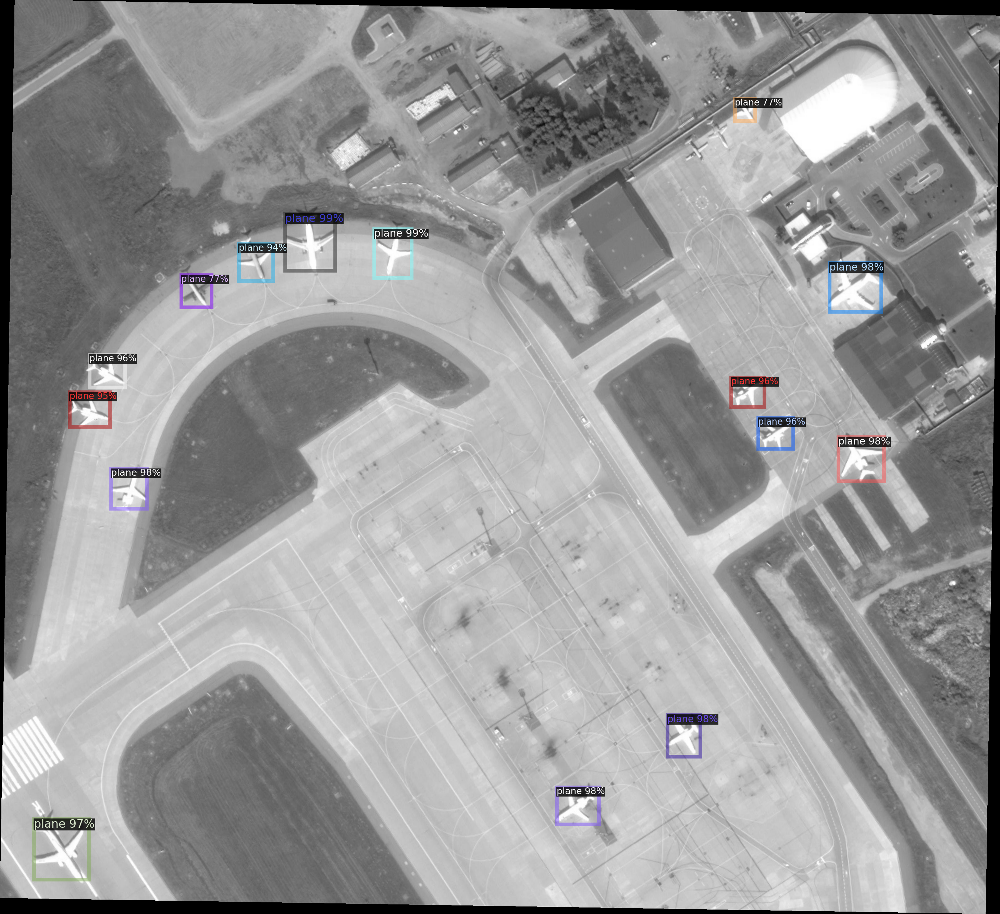

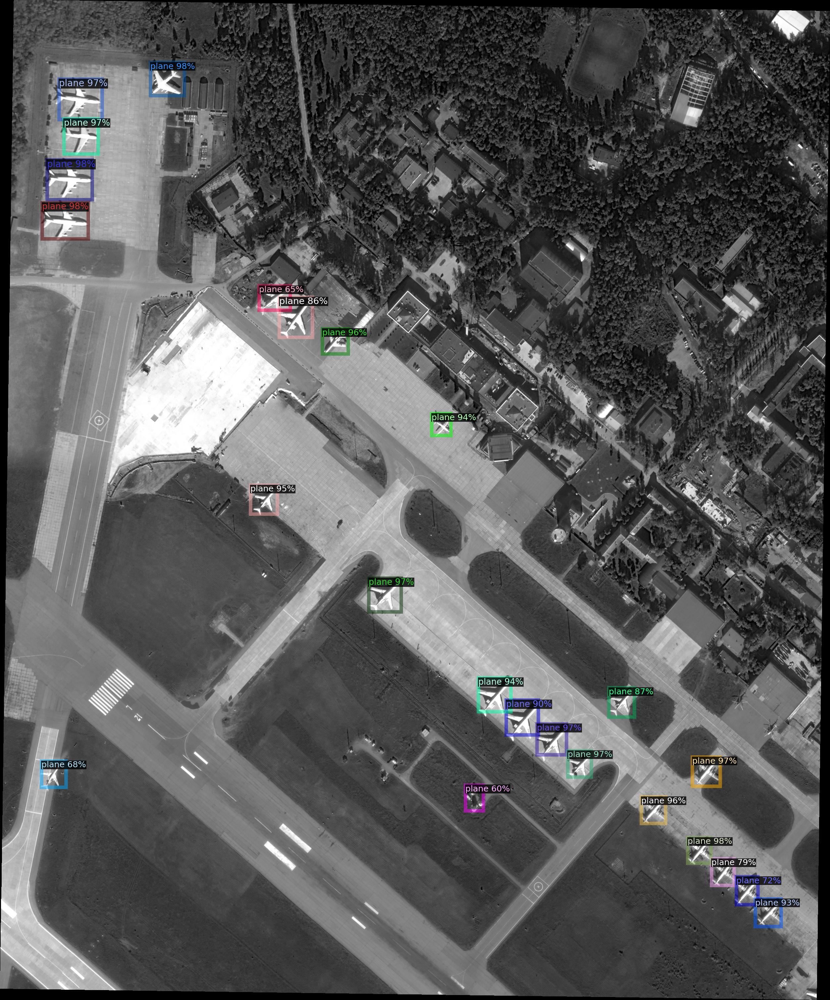

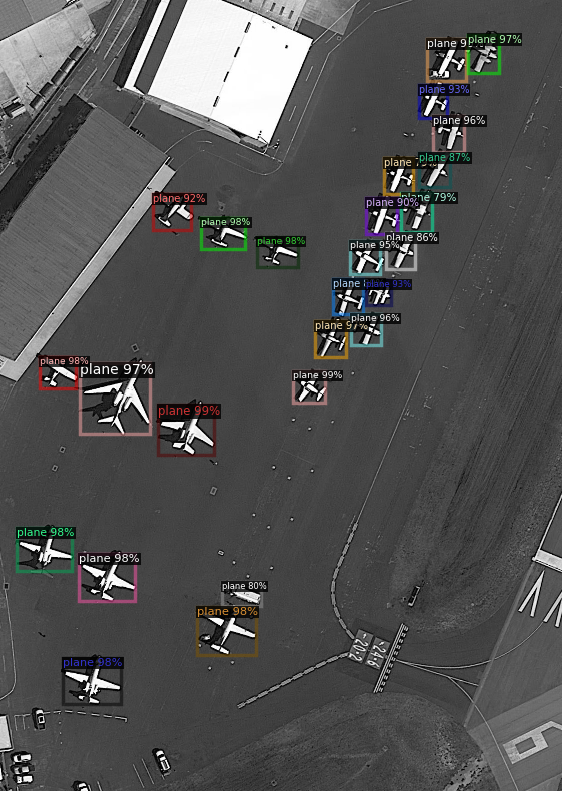

In [16]:
'''
# Visualize the output for 3 random test samples
# TODO: approx 10 lines
'''
from detectron2.utils.visualizer import ColorMode
# dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(test_data, 3):
    im = d['image_data']#cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=plane_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
#     cv2_imshow(out.get_image()[:, :, ::-1])
    im = Image.fromarray(out.get_image()[:, :, ::-1])
    #     print(d['filename'])
    display(im)

In [12]:
'''
# Use COCOEvaluator and build_detection_train_loader
# You can save the output predictions using inference_on_dataset
# TODO: approx 5 lines
'''
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("data_detection_test", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "data_detection_test")
results = inference_on_dataset(predictor.model, val_loader, evaluator)
print(results)

NameError: name 'cfg' is not defined

### Improvements

For this part, you can bring any improvement which you have by adding new input parameters to the previous functions or defining new functions and variables.

In [ ]:
'''
# Bring any changes and updates regarding the improvement in here
'''


## Part 2: Semantic Segmentation

### Data Loader

In [ ]:
'''
# Write a function that returns the cropped image and corresponding mask regarding the target bounding box
# idx is the index of the target bbox in the data
# high-resolution image could be passed or could be load from data['file_name']
# You can use the mask attribute of detectron2.utils.visualizer.GenericMask
#     to convert the segmentation annotations to binary masks
# TODO: approx 10 lines
'''

def get_instance_sample(data, idx, img=None):

  return obj_img, obj_mask

In [ ]:
'''
# We have provided a template data loader for your segmentation training
# You need to complete the __getitem__() function before running the code
# You may also need to add data augmentation or normalization in here
'''

class PlaneDataset(Dataset):
  def __init__(self, set_name, data_list):
      self.transforms = transforms.Compose([
          transforms.ToTensor(), # Converting the image to tensor and change the image format (Channels-Last => Channels-First)
      ])
      self.set_name = set_name
      self.data = data_list
      self.instance_map = []
      for i, d in enumerate(self.data):
        for j in range(len(d['annotations'])):
          self.instance_map.append([i,j])

  '''
  # you can change the value of length to a small number like 10 for debugging of your training procedure and overfeating
  # make sure to use the correct length for the final training
  '''
  def __len__(self):
      return len(self.instance_map)

  def numpy_to_tensor(self, img, mask):
    if self.transforms is not None:
        img = self.transforms(img)
    img = torch.tensor(img, dtype=torch.float)
    mask = torch.tensor(mask, dtype=torch.float)
    return img, mask

  '''
  # Complete this part by using get_instance_sample function
  # make sure to resize the img and mask to a fixed size (for example 128*128)
  # you can use "interpolate" function of pytorch or "numpy.resize"
  # TODO: 5 lines
  '''
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()
    idx = self.instance_map[idx]
    data = self.data[idx[0]]


    return img, mask

def get_plane_dataset(set_name='train', batch_size=2):
    my_data_list = DatasetCatalog.get("data_detection_{}".format(set_name))
    dataset = PlaneDataset(set_name, my_data_list)
    loader = DataLoader(dataset, batch_size=batch_size, num_workers=4,
                                              pin_memory=True, shuffle=True)
    return loader, dataset

### Network

In [ ]:
'''
# convolution module as a template layer consists of conv2d layer, batch normalization, and relu activation
'''
class conv(nn.Module):
    def __init__(self, in_ch, out_ch, activation=True):
        super(conv, self).__init__()
        if(activation):
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1),
             nn.BatchNorm2d(out_ch),
             nn.ReLU(inplace=True)
          )
        else:
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1)
             )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# downsampling module equal to a conv module followed by a max-pool layer
'''
class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.layer = nn.Sequential(
            conv(in_ch, out_ch),
            nn.MaxPool2d(2)
            )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# upsampling module equal to a upsample function followed by a conv module
'''
class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=False):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

        self.conv = conv(in_ch, out_ch)

    def forward(self, x):
        y = self.up(x)
        y = self.conv(y)
        return y

'''
# the main model which you need to complete by using above modules.
# you can also modify the above modules in order to improve your results.
'''
class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()

        # Encoder

        self.input_conv = conv(3, 4)
        self.down = down(4, 8)

        # Decoder

        self.up = up(8, 4)
        self.output_conv = conv(4, 1, False) # ReLu activation is removed to keep the logits for the loss function


    def forward(self, input):
      y = self.input_conv(input)
      y = self.down(y)
      y = self.up(y)
      output = self.output_conv(y)
      return output

### Training

In [ ]:
'''
# The following is a basic training procedure to train the network
# You need to update the code to get the best performance
# TODO: approx ? lines
'''

# Set the hyperparameters
num_epochs = 5
batch_size = 4
learning_rate = 0.01
weight_decay = 1e-5

model = MyModel() # initialize the model
model = model.cuda() # move the model to GPU
loader, _ = get_plane_dataset('train', batch_size) # initialize data_loader
crit = nn.BCEWithLogitsLoss() # Define the loss function
optim = torch.optim.SGD(model.parameters(), lr=learning_rate, weight_decay=weight_decay) # Initialize the optimizer as SGD

# start the training procedure
for epoch in range(num_epochs):
  total_loss = 0
  for (img, mask) in tqdm(loader):
    img = torch.tensor(img, device=torch.device('cuda'), requires_grad = True)
    mask = torch.tensor(mask, device=torch.device('cuda'), requires_grad = True)
    pred = model(img)
    loss = crit(pred, mask)
    optim.zero_grad()
    loss.backward()
    optim.step()
    total_loss += loss.cpu().data
  print("Epoch: {}, Loss: {}".format(epoch, total_loss/len(loader)))
  torch.save(model.state_dict(), '{}/output/{}_segmentation_model.pth'.format(BASE_DIR, epoch))

'''
# Saving the final model
'''
torch.save(model.state_dict(), '{}/output/final_segmentation_model.pth'.format(BASE_DIR))


### Evaluation and Visualization

In [ ]:
'''
# Before starting the evaluation, you need to set the model mode to eval
# You may load the trained model again, in case if you want to continue your code later
# TODO: approx 15 lines
'''
batch_size = 8
model = MyModel().cuda()
model.load_state_dict(torch.load('{}/output/final_segmentation_model.pth'.format(BASE_DIR)))
model = model.eval() # chaning the model to evaluation mode will fix the bachnorm layers
loader, dataset = get_plane_dataset('train', batch_size)

total_iou = 0
for (img, mask) in tqdm(loader):
  with torch.no_grad():
    img = img.cuda()
    mask = mask.cuda()
    mask = torch.unsqueeze(mask,1)
    pred = model(img)

    '''
    ## Complete the code by obtaining the IoU for each img and print the final Mean IoU
    '''


print("\n #images: {}, Mean IoU: {}".format(_, _))


In [ ]:
'''
# Visualize 3 sample outputs
# TODO: approx 5 lines
'''


## Part 3: Instance Segmentation

In this part, you need to obtain the instance segmentation results for the test data by using the trained segmentation model in the previous part and the detection model in Part 1.

### Get Prediction

In [ ]:
'''
# Define a new function to obtain the prediction mask by passing a sample data
# For this part, you need to use all the previous parts (predictor, get_instance_sample, data preprocessings, etc)
# It is better to keep everything (as well as the output of this funcion) on gpu as tensors to speed up the operations.
# pred_mask is the instance segmentation result and should have different values for different planes.
# TODO: approx 35 lines
'''

def get_prediction_mask(data):

  return img, gt_mask, pred_mask # gt_mask could be all zero when the ground truth is not given.


### Visualization and Submission

In [ ]:
'''
# Visualise the output prediction as well as the GT Mask and Input image for a sample input
# TODO: approx 10 lines
'''



In [ ]:
'''
# ref: https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# https://www.kaggle.com/c/airbus-ship-detection/overview/evaluation
'''
def rle_encoding(x):
    '''
    x: pytorch tensor on gpu, 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = torch.where(torch.flatten(x.long())==1)[0]
    if(len(dots)==0):
      return []
    inds = torch.where(dots[1:]!=dots[:-1]+1)[0]+1
    inds = torch.cat((torch.tensor([0], device=torch.device('cuda'), dtype=torch.long), inds))
    tmpdots = dots[inds]
    inds = torch.cat((inds, torch.tensor([len(dots)], device=torch.device('cuda'))))
    inds = inds[1:] - inds[:-1]
    runs = torch.cat((tmpdots, inds)).reshape((2,-1))
    runs = torch.flatten(torch.transpose(runs, 0, 1)).cpu().data.numpy()
    return ' '.join([str(i) for i in runs])

In [ ]:
'''
# You need to upload the csv file on kaggle
# The speed of your code in the previous parts highly affects the running time of this part
'''

preddic = {"ImageId": [], "EncodedPixels": []}

'''
# Writing the predictions of the training set
'''
my_data_list = DatasetCatalog.get("data_detection_{}".format('train'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for index in inds:
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index)
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

'''
# Writing the predictions of the test set
'''

my_data_list = DatasetCatalog.get("data_detection_{}".format('test'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for j, index in enumerate(inds):
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index).double()
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

pred_file = open("{}/pred.csv".format(BASE_DIR), 'w')
pd.DataFrame(preddic).to_csv(pred_file, index=False)
pred_file.close()


## Part 4: Mask R-CNN

For this part you need to follow a same procedure to part 2 with the configs of Mask R-CNN, other parts are generally the same as part 2.

### Data Loader

### Network

### Training

### Evaluation and Visualization